In [241]:
import ee
from geetiles import gee
from geetiles import utils
import geopandas as gpd
import rasterio
from importlib import reload
from rlxutils import subplots
import matplotlib.pyplot as plt
import numpy as np
import os
import contextily as cx
import glob
from progressbar import progressbar as pbar
reload(gee)

<module 'geetiles.gee' from '/home/rlx/geetiles/geetiles/gee.py'>

# select a random chipset and a random chip within it

In [190]:
basedir = "/opt/earthdata/chipsets"
dataset = 's1grd-2022'

files = glob.glob(f"{basedir}/*/{dataset}/*.tif")
chipsets = np.unique([file.split("/")[-3] for file in files])


In [192]:
chipset = np.random.choice(chipsets)
chipset = '235492c72fa62_partitions_aschips_299de3d3ec673'

chipset_files = [f for f in files if chipset in f]
len(chipset_files)

167

In [193]:
z = gpd.read_file(f"{basedir}/{chipset}.geojson")
z01 = z[z.group.isin(['0','1'])]
z.shape, z01.shape

((1729, 4), (175, 4))

In [ ]:
z01.explore()

In [239]:
len(chipset_files)

167

| |                                     #           | 166 Elapsed Time: 0:00:13


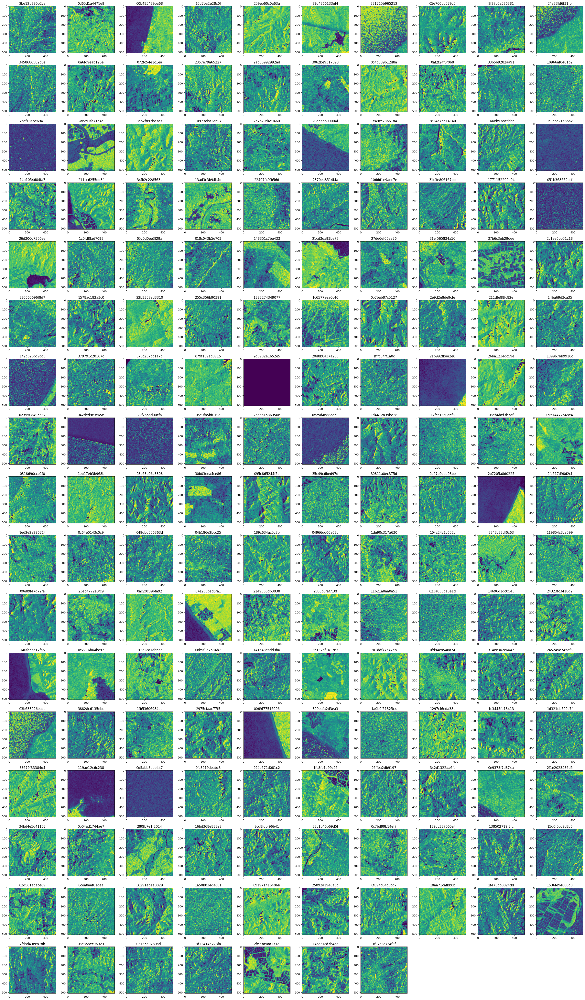

In [243]:
chipset_file = np.random.choice(chipset_files)
chipset_file = [i for i in chipset_files if '314e' in i][0]


for ax,chipset_file in pbar(subplots(chipset_files, n_cols=10)):
    identifier = chipset_file.split("/")[-1].split(".")[0]

    c = z[z.identifier==identifier].iloc[0]
    with rasterio.open(chipset_file) as f:
        x = f.read()
        d = f.descriptions
        p = f.profile.copy()
    x.shape, x.dtype
    a,b = np.percentile(x[1], (1,99))
    plt.imshow(x[1], vmin=a, vmax=b)
    plt.title(identifier)

In [251]:
chipset_file = [i for i in chipset_files if '13ad' in i][0]
chipset_file = [i for i in chipset_files if '0cea' in i][0]
identifier = chipset_file.split("/")[-1].split(".")[0]
c = z[z.identifier==identifier].iloc[0]


In [252]:
c

area_km2                                              26.204169
identifier                                        0cea8aaf81dea
group                                                         1
geometry      POLYGON ((-80.595931560817 -4.514282607909162,...
Name: 614, dtype: object

In [ ]:
z[z.identifier==identifier].explore()

In [256]:
    with rasterio.open(chipset_file) as f:
        x = f.read()
        d = f.descriptions
        p = f.profile.copy()


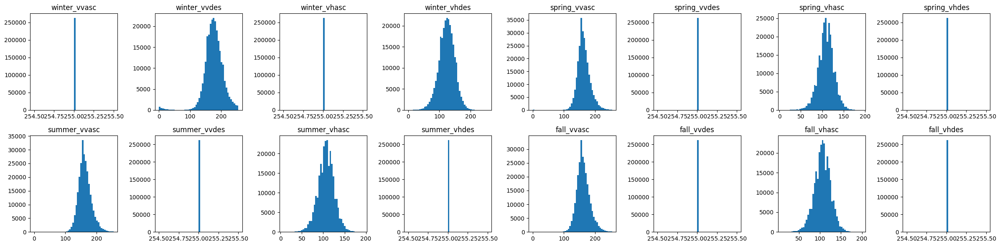

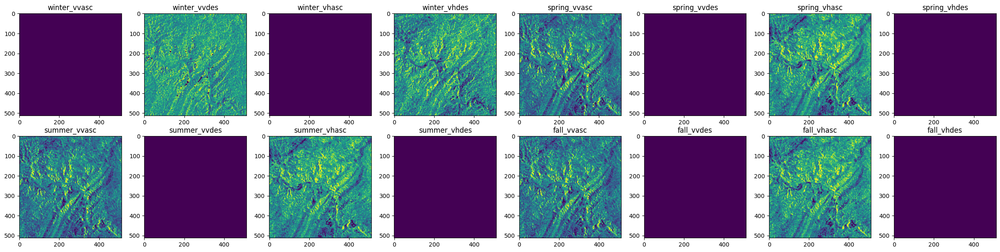

In [257]:
for ax,i in subplots(len(d), n_cols=8):
    plt.hist(x[i].flatten(), bins=50);
    plt.title(d[i])
    
for ax,i in subplots(len(d), n_cols=8):
    a,b = np.percentile(x[i], (1,99))
    plt.imshow(x[i], vmin=a, vmax=b)
    plt.title(d[i])

# interesting chips

In [158]:
13ad3c3b94b4d,  '/opt/earthdata/chipsets/235492c72fa62_partitions_aschips_299de3d3ec673/s1grd-2022/13ad3c3b94b4d.tif'

area_km2                                              26.204167
identifier                                        1ed2e2a296714
group                                                         0
geometry      POLYGON ((-80.2284619285932 -2.337117475049614...
Name: 1369, dtype: object

In [159]:
chipset_file

'/opt/earthdata/chipsets/235492c72fa62_partitions_aschips_299de3d3ec673/s1grd-2022/1ed2e2a296714.tif'